<h1 style="font-size:30px;">Background Removal using U2-Net and U2-NetP</h1>

<center><img src="https://learnopencv.com/wp-content/uploads/2024/06/U2-Net-vs-U2-NetP-sample-predictions.png" width=700></center>

## Imports

In [1]:
# Uncomment the following lines if you don't have gdown and torchinfo installed.
!pip install -qq gdown
!pip install -qq torchinfo

In [2]:
import os
import requests
import gdown
from zipfile import ZipFile

from PIL import Image
import numpy as np

from torchinfo import summary

import torch
import torchvision.transforms as T

import torchvision.transforms.functional as F

import matplotlib.pyplot as plt

In [3]:
DEVICE = "cuda:0" if torch.cuda.is_available() else "cpu"

## Download Official Models: U2Net and U2NetP

We shall download the models hosted from gdrive by the authors.

In [4]:
U2NET_MODEL_URL = "https://drive.google.com/uc?id=1ao1ovG1Qtx4b7EoskHXmi2E9rp5CHLcZ"
U2NETP_MODEL_URL = "https://drive.google.com/uc?id=1rbSTGKAE-MTxBYHd-51l2hMOQPT_7EPy"

U2NET_MODEL_PATH = "u2net.pth"
U2NETP_MODEL_PATH = "u2netp.pth"

In [5]:
if not os.path.exists(os.path.join(os.getcwd(), U2NET_MODEL_PATH)):
    _ = gdown.download(U2NET_MODEL_URL, U2NET_MODEL_PATH)

if not os.path.exists(os.path.join(os.getcwd(), U2NETP_MODEL_PATH)):
    _ = gdown.download(U2NETP_MODEL_URL, U2NETP_MODEL_PATH)

Downloading...
From (original): https://drive.google.com/uc?id=1ao1ovG1Qtx4b7EoskHXmi2E9rp5CHLcZ
From (redirected): https://drive.google.com/uc?id=1ao1ovG1Qtx4b7EoskHXmi2E9rp5CHLcZ&confirm=t&uuid=a7bc5f4c-7632-4171-87a8-5827ac425931
To: /content/u2net.pth
100%|██████████| 176M/176M [00:02<00:00, 63.3MB/s]
Downloading...
From: https://drive.google.com/uc?id=1rbSTGKAE-MTxBYHd-51l2hMOQPT_7EPy
To: /content/u2netp.pth
100%|██████████| 4.68M/4.68M [00:00<00:00, 35.7MB/s]


## Download Sample Images

In [6]:
def download_and_unzip(url, save_path):

    print("Downloading and extracting assets...", end="")
    file = requests.get(url)
    # print(file.status_code)
    open(save_path, "wb").write(file.content)

    try:
        # Extract zipfile.
        if save_path.endswith(".zip"):
            with ZipFile(save_path) as zip:
                zip.extractall(os.path.split(save_path)[0])

        print("Done")
    except:
        print("Invalid file")

In [7]:
TEST_IMAGE_DIR = "test_images"
TEST_DIR_ZIP = TEST_IMAGE_DIR+".zip"
IMAGE_DATA_URL = "https://www.dropbox.com/scl/fi/266ke2me03xgt74vdrb4x/test_images.zip?rlkey=ipul6odyiw596up1bf24dgnky&st=8a04ypoc&dl=1"

SCRIPTS_URL = "https://www.dropbox.com/scl/fo/bsqlkbvnajghhoeljf7kw/APphPibd3WjoeMHZ0IO6Q_Y?rlkey=0nqlamncqg1x0tv6hyd5unj3h&st=cq4012mz&dl=1"
SCRIPTS_ZIP = "scripts.zip"

if not os.path.exists(os.path.join(os.getcwd(), "test_images")):
    download_and_unzip(IMAGE_DATA_URL, TEST_DIR_ZIP)
    os.remove(TEST_DIR_ZIP)

if not os.path.exists(os.path.join(os.getcwd(), "u2net.py")):
    download_and_unzip(SCRIPTS_URL, SCRIPTS_ZIP)
    os.remove(SCRIPTS_ZIP)

## Load Model Weights

In [8]:
from u2net import U2NET, U2NETP

### Model Initialization

In [9]:
u2net = U2NET(in_ch=3,out_ch=1)
u2netp = U2NETP(in_ch=3,out_ch=1)

### Model Summary

In [10]:
print(f"{'U2NET Model Summary':=^90}")
print(summary(u2net, input_size=(1,3,320,320), device="cpu", depth=1, row_settings=["var_names"]))

===================================U2NET Model Summary====================================
Layer (type (var_name))                  Output Shape              Param #
U2NET (U2NET)                            [1, 1, 320, 320]          --
├─RSU7 (stage1)                          [1, 64, 320, 320]         206,016
├─MaxPool2d (pool12)                     [1, 64, 160, 160]         --
├─RSU6 (stage2)                          [1, 128, 160, 160]        305,856
├─MaxPool2d (pool23)                     [1, 128, 80, 80]          --
├─RSU5 (stage3)                          [1, 256, 80, 80]          1,108,992
├─MaxPool2d (pool34)                     [1, 256, 40, 40]          --
├─RSU4 (stage4)                          [1, 512, 40, 40]          3,986,688
├─MaxPool2d (pool45)                     [1, 512, 20, 20]          --
├─RSU4F (stage5)                         [1, 512, 20, 20]          10,034,688
├─MaxPool2d (pool56)                     [1, 512, 10, 10]          --
├─RSU4F (stage6)                

In [11]:
print(f"{'U2NETP Model Summary':=^90}")
print(summary(u2netp, input_size=(1,3,320,320), device="cpu", depth=1, row_settings=["var_names"]))

===================================U2NETP Model Summary===================================
Layer (type (var_name))                  Output Shape              Param #
U2NETP (U2NETP)                          [1, 1, 320, 320]          --
├─RSU7 (stage1)                          [1, 64, 320, 320]         67,200
├─MaxPool2d (pool12)                     [1, 64, 160, 160]         --
├─RSU6 (stage2)                          [1, 64, 160, 160]         95,328
├─MaxPool2d (pool23)                     [1, 64, 80, 80]           --
├─RSU5 (stage3)                          [1, 64, 80, 80]           88,320
├─MaxPool2d (pool34)                     [1, 64, 40, 40]           --
├─RSU4 (stage4)                          [1, 64, 40, 40]           81,312
├─MaxPool2d (pool45)                     [1, 64, 20, 20]           --
├─RSU4F (stage5)                         [1, 64, 20, 20]           81,312
├─MaxPool2d (pool56)                     [1, 64, 10, 10]           --
├─RSU4F (stage6)                         [1,

### Load Pre-trained Model Weights for U2-Net and U2-NetP

In [12]:
def load_model(model, model_path, device):

    model.load_state_dict(torch.load(model_path, map_location=device))
    model = model.to(device)

    return model

In [13]:
u2net = load_model(model=u2net, model_path=U2NET_MODEL_PATH, device=DEVICE)

u2netp = load_model(model=u2netp, model_path=U2NETP_MODEL_PATH, device=DEVICE)

## Data Preprocessing

In [14]:
MEAN = torch.tensor([0.485, 0.456, 0.406])
STD = torch.tensor([0.229, 0.224, 0.225])

resize_shape = (320,320)

transforms = T.Compose([T.ToTensor(),
                        T.Normalize(mean=MEAN, std=STD)])

### De-Normalize Image

In [15]:
def denorm_image(image, mean, std):
    image_denorm = torch.addcmul(mean[:,None,None], image, std[:,None, None])
    image = torch.clamp(image_denorm*255., min=0., max=255.)
    image = torch.permute(image, dims=(1,2,0)).numpy().astype("uint8")

    return image

### Prepare Image Batch

In [16]:
def prepare_image_batch(image_dir, resize, transforms, device):

    image_batch = []

    for image_file in os.listdir(image_dir):
        image = Image.open(os.path.join(image_dir, image_file)).convert("RGB")
        image_resize = image.resize(resize, resample = Image.BILINEAR)

        image_trans = transforms(image_resize)
        image_batch.append(image_trans)


    image_batch = torch.stack(image_batch).to(device)

    return image_batch

In [17]:
image_batch = prepare_image_batch(image_dir=TEST_IMAGE_DIR,
                                 resize=resize_shape,
                                 transforms=transforms,
                                 device=DEVICE)

## Model Predictions

In [18]:
def prepare_predictions(model, image_batch):

    model.eval()

    all_results = []

    for image in image_batch:
        with torch.no_grad():
            results = model(image.unsqueeze(dim=0))

        all_results.append(torch.squeeze(results[0].cpu(), dim=(0,1)).numpy())

    return all_results

In [19]:
predictions_u2net = prepare_predictions(u2net, image_batch)
predictions_u2netp = prepare_predictions(u2netp, image_batch)

### Normalize Model Predictions

In [20]:
def normPRED(predicted_map):
    ma = np.max(predicted_map)
    mi = np.min(predicted_map)

    map_normalize = (predicted_map - mi) / (ma-mi)

    return map_normalize

## Prediction Visualizations

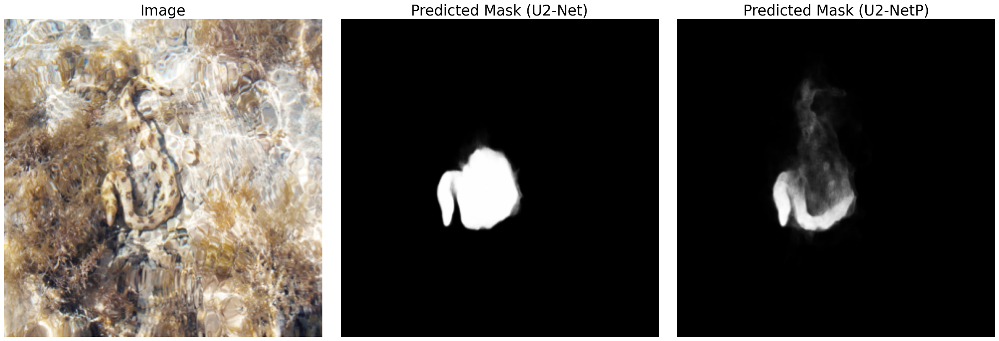

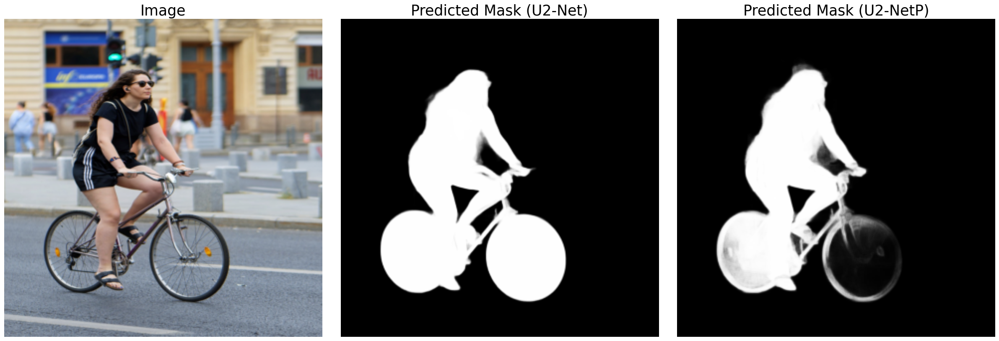

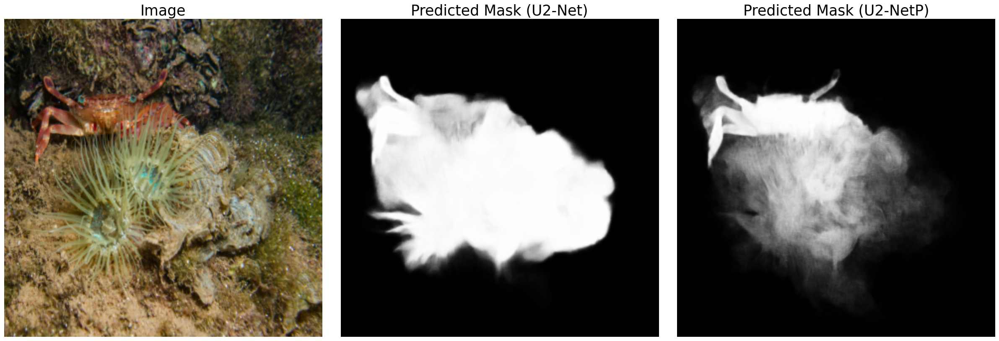

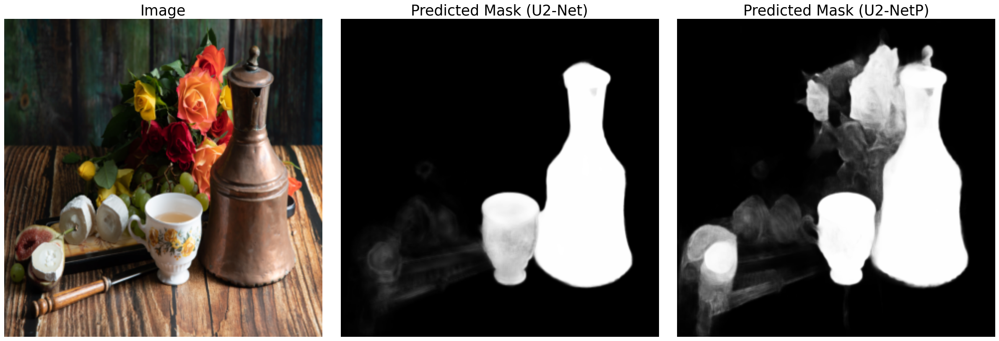

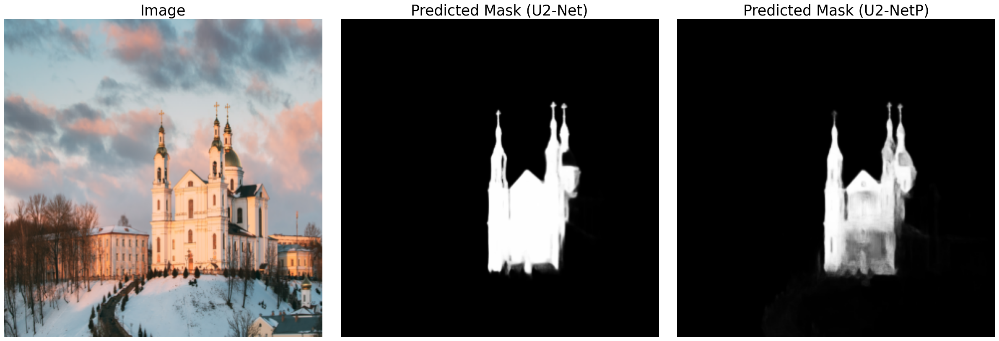

...

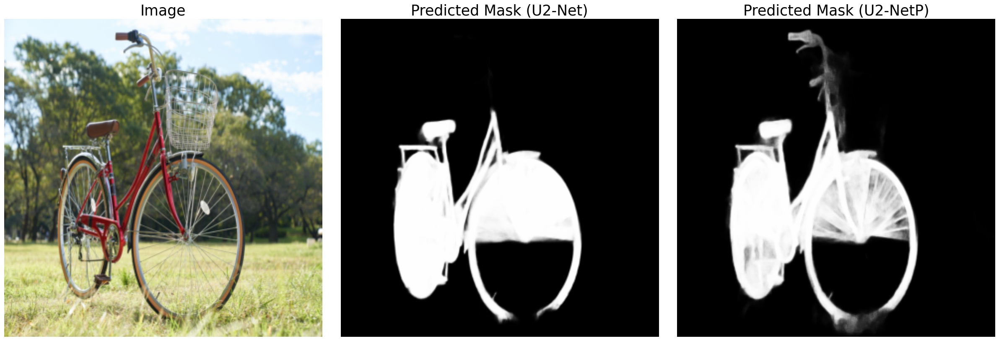

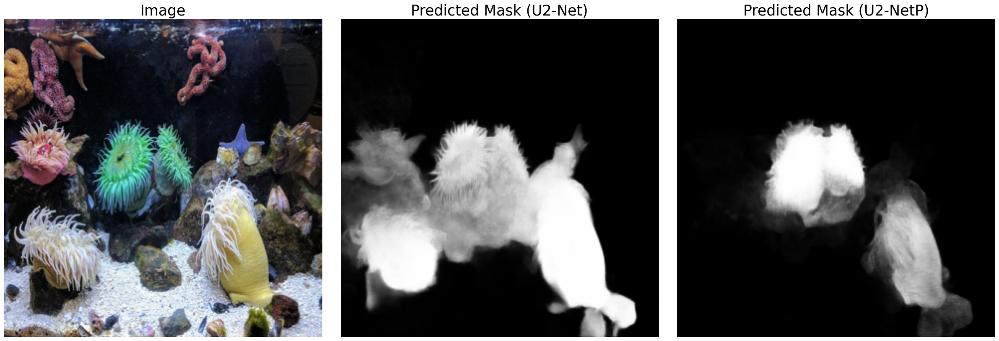

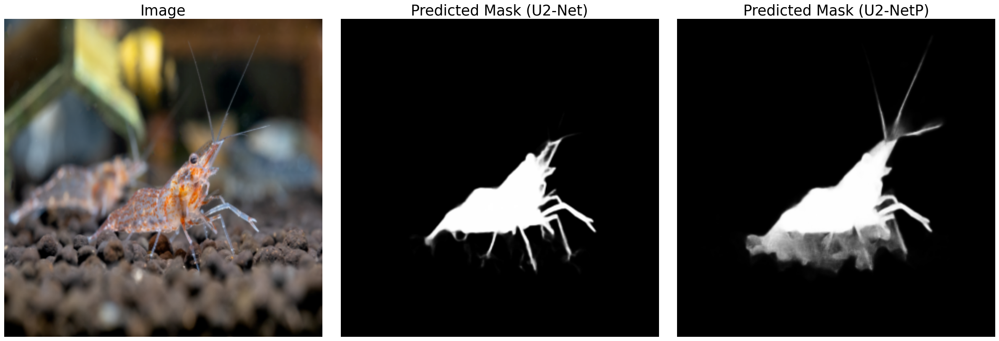

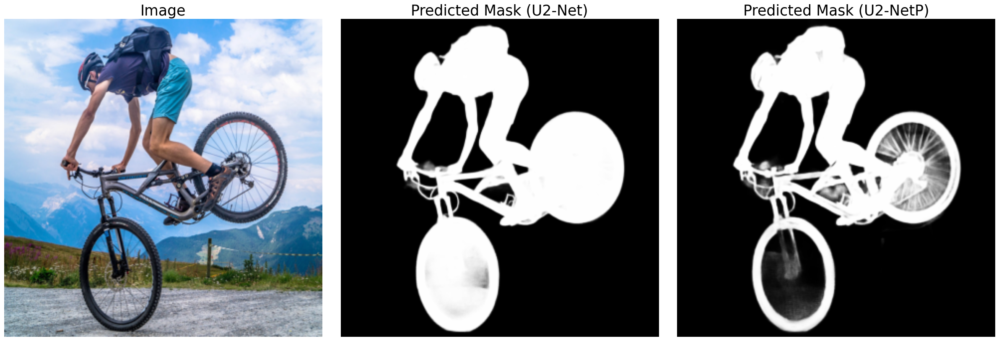

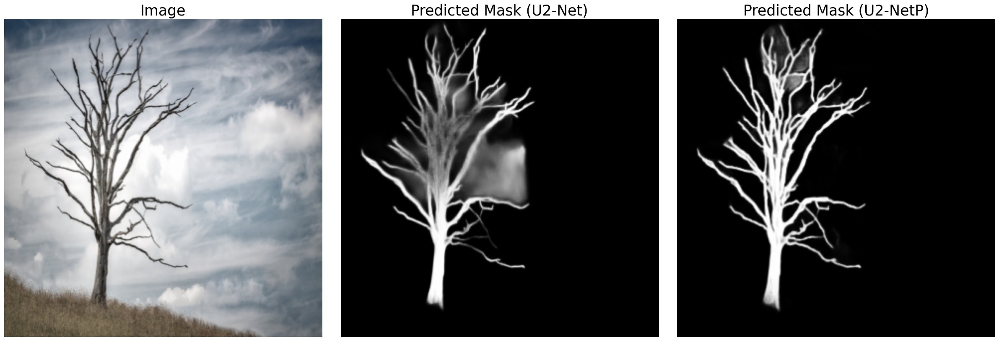

In [21]:
for idx, (og_image, result_u2net, result_u2netp) in enumerate(zip(image_batch.cpu(),
                                               predictions_u2net,
                                               predictions_u2netp),1):

    pred_normalize_u2net = normPRED(result_u2net)
    pred_final_u2net = np.clip(pred_normalize_u2net*255., a_min=0, a_max=255.).astype("uint8")

    pred_normalize_u2netp = normPRED(result_u2netp)
    pred_final_u2netp = np.clip(pred_normalize_u2netp*255., a_min=0, a_max=255.).astype("uint8")

    image = denorm_image(og_image, mean=MEAN, std=STD)

    plt.figure(figsize=(24,8), layout="constrained")

    plt.subplot(1,3,1)
    plt.imshow(image)
    plt.title("Image", fontsize = 25)
    plt.axis("off")

    plt.subplot(1,3,2)
    plt.imshow(pred_final_u2net, cmap="gray")
    plt.title("Predicted Mask (U2-Net)", fontsize=25)
    plt.axis("off")

    plt.subplot(1,3,3)
    plt.imshow(pred_final_u2netp, cmap="gray")
    plt.title("Predicted Mask (U2-NetP)", fontsize=25)
    plt.axis("off")

    plt.show()
    plt.close()

## References

https://github.com/xuebinqin/U-2-Net